# Download Dataset

In [ ]:
!curl -L "https://universe.roboflow.com/ds/XXu9MsOyHK?key=1PG2UEJ3Fh" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

Streaming output truncated to the last 5000 lines.
 extracting: train/egohands-public-1625254247727_png_jpg.rf.f8b4e7725c233d902f1a30c446f5f651.xml  
 extracting: train/egohands-public-1625254250331_png_jpg.rf.0b8622617e6348d94f0e5b8cd8379434.jpg  
 extracting: train/egohands-public-1625254250331_png_jpg.rf.0b8622617e6348d94f0e5b8cd8379434.xml  
 extracting: train/egohands-public-1625254250331_png_jpg.rf.352eccb403bda7d7269e2a50a9990119.jpg  
 extracting: train/egohands-public-1625254250331_png_jpg.rf.352eccb403bda7d7269e2a50a9990119.xml  
 extracting: train/egohands-public-1625254250331_png_jpg.rf.d57fd2ab7a6f1f691fccb5c6fc8f2af9.jpg  
 extracting: train/egohands-public-1625254250331_png_jpg.rf.d57fd2ab7a6f1f691fccb5c6fc8f2af9.xml  
 extracting: train/egohands-public-1625254251181_png_jpg.rf.8705421c1c625ec1df118a163e3139d3.jpg  
 extracting: train/egohands-public-1625254251181_png_jpg.rf.8705421c1c625ec1df118a163e3139d3.xml  
 extracting: train/egohands-public-1625254251181_png_jpg.r

# Function to evaluate model

In [ ]:
# Import packages
import os
import cv2
import numpy as np
import sys
import glob
import random
import importlib.util
from tensorflow.lite.python.interpreter import Interpreter
import matplotlib
import matplotlib.pyplot as plt
import time

%matplotlib inline

# Define function for inferencing with TFLite model and displaying results
def tflite_detect_images(modelpath, imgpath, lblpath, min_conf=0.5, num_test_images=10, savepath='/content/results', txt_only=False):

    # Grab filenames of all images in test folder
    images = glob.glob(imgpath + '/*.jpg') + glob.glob(imgpath + '/*.JPG') + glob.glob(imgpath + '/*.png') + glob.glob(imgpath + '/*.bmp')

    # Load the label map into memory
    with open(lblpath, 'r') as f:
        labels = [line.strip() for line in f.readlines()]

    # Load the Tensorflow Lite model into memory
    interpreter = Interpreter(model_path=modelpath)
    interpreter.allocate_tensors()

    # Get model details
    input_details = interpreter.get_input_details()
    output_details = interpreter.get_output_details()
    height = input_details[0]['shape'][1]
    width = input_details[0]['shape'][2]
    float_input = (input_details[0]['dtype'] == np.float32)
    input_mean = 127.5
    input_std = 127.5

    # Randomly select test images
    images_to_test = random.sample(images, num_test_images)

    # Loop over every image and perform detection
    for image_path in images_to_test:
        # Load image and resize to expected shape [1xHxWx3]
        image = cv2.imread(image_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        imH, imW, _ = image.shape
        image_resized = cv2.resize(image_rgb, (width, height))
        input_data = np.expand_dims(image_resized, axis=0)

        # Normalize pixel values if using a floating model (i.e., if model is non-quantized)
        if float_input:
            input_data = (np.float32(input_data) - input_mean) / input_std

        # Measure inference time
        start_time = time.time()
        # Perform the actual detection by running the model with the image as input
        interpreter.set_tensor(input_details[0]['index'], input_data)
        interpreter.invoke()
        inference_time = time.time() - start_time  # Calculate inference time

        print(f"Inference time for {os.path.basename(image_path)}: {inference_time:.4f} seconds")

        # Retrieve detection results
        boxes = interpreter.get_tensor(output_details[1]['index'])[0]
        classes = interpreter.get_tensor(output_details[3]['index'])[0]
        scores = interpreter.get_tensor(output_details[0]['index'])[0]

        detections = []

        # Loop over all detections and draw detection box if confidence is above minimum threshold
        for i in range(len(scores)):
            if (scores[i] > min_conf) and (scores[i] <= 1.0):
                ymin = int(max(1, (boxes[i][0] * imH)))
                xmin = int(max(1, (boxes[i][1] * imW)))
                ymax = int(min(imH, (boxes[i][2] * imH)))
                xmax = int(min(imW, (boxes[i][3] * imW)))

                cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (10, 255, 0), 2)

                object_name = labels[int(classes[i])]
                label = f'{object_name}: {int(scores[i]*100)}%'
                labelSize, baseLine = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2)
                label_ymin = max(ymin, labelSize[1] + 10)
                cv2.rectangle(image, (xmin, label_ymin - labelSize[1] - 10), (xmin + labelSize[0], label_ymin + baseLine - 10), (255, 255, 255), cv2.FILLED)
                cv2.putText(image, label, (xmin, label_ymin - 7), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 0), 2)

                detections.append([object_name, scores[i], xmin, ymin, xmax, ymax])

        # Display or save results
        if not txt_only:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            plt.figure(figsize=(12,16))
            plt.imshow(image)
            plt.show()
        else:
            image_fn = os.path.basename(image_path)
            base_fn, ext = os.path.splitext(image_fn)
            txt_result_fn = base_fn + '.txt'
            txt_savepath = os.path.join(savepath, txt_result_fn)

            with open(txt_savepath, 'w') as f:
                for detection in detections:
                    f.write('%s %.4f %d %d %d %d\n' % (detection[0], detection[1], detection[2], detection[3], detection[4], detection[5]))

    return


# Unzip Model

In [ ]:
!unzip midtermsSSD.zip

Archive:  midtermsSSD.zip
replace content/custom_model_lite/detect.tflite? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

# Create Labelmap.txt

In [ ]:
### This creates a a "labelmap.txt" file with a list of classes the object detection model will detect.
%%bash
cat <<EOF >> /content/labelmap.txt
Paper
Rock
Scissors
EOF

# Load Model and set test dataset for inference

Inference time for 20220216_222153_jpg.rf.a2bd5f6dd7833d67c9cb2e1d9ca298cc.jpg: 0.0465 seconds


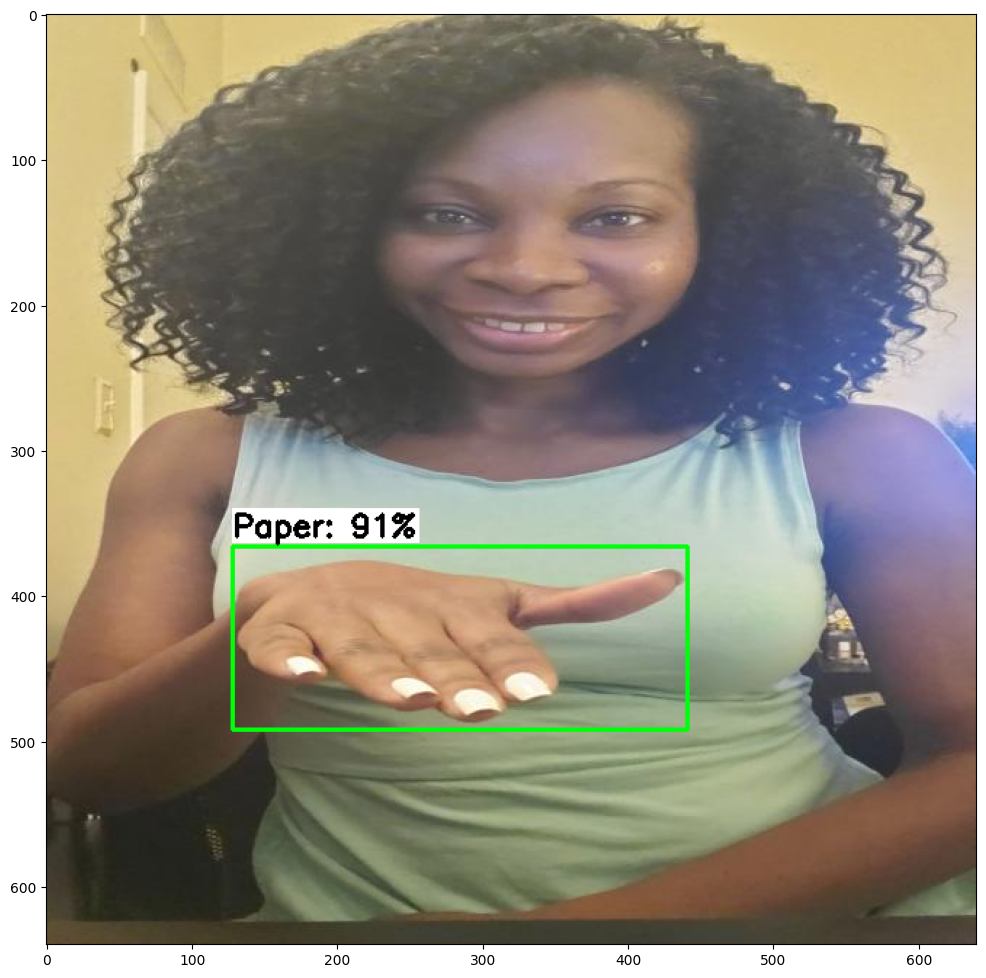

Inference time for zoom_tests_RockPaperScissors-mohamed_mp4-291_jpg.rf.d534df04c30fd69fdda812687610b6e2.jpg: 0.0770 seconds


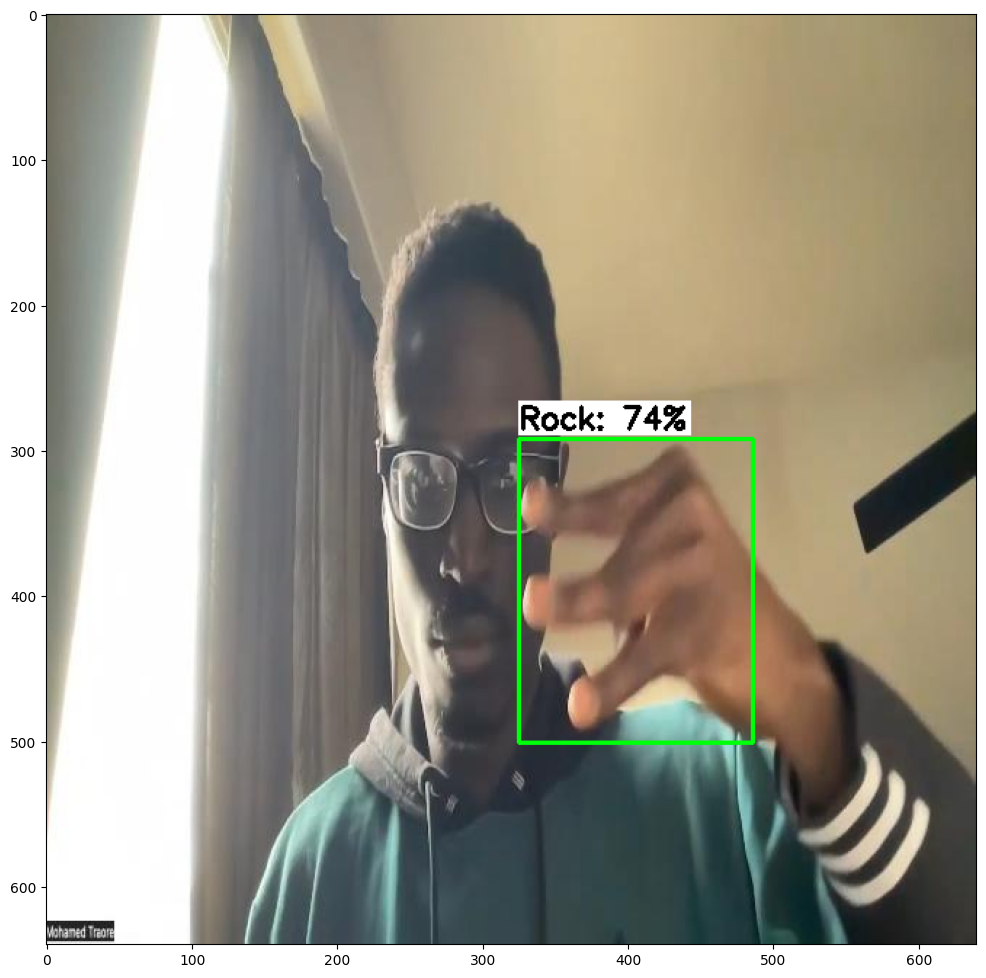

Inference time for IMG_7043_MOV-177_jpg.rf.eb554844ab1f6aca4a93b965884e813b.jpg: 0.0668 seconds


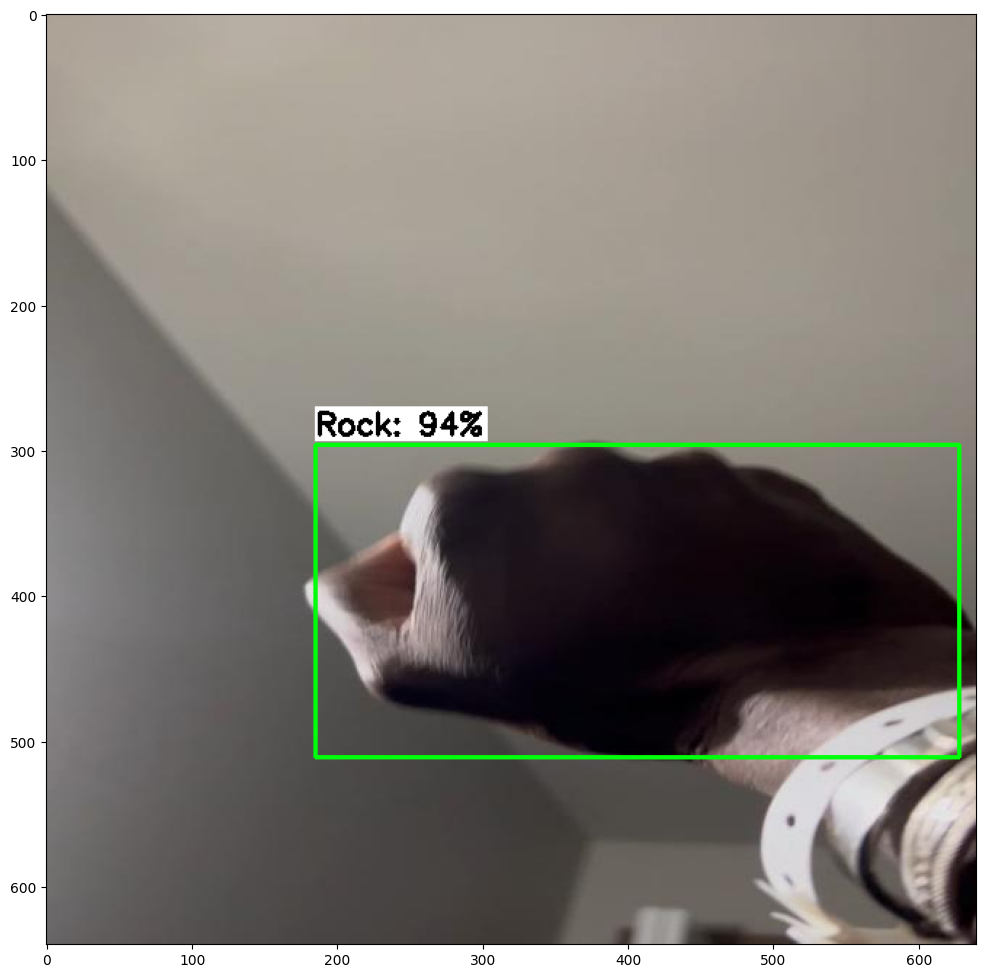

Inference time for egohands-public-1624053425083_png_jpg.rf.d52bb48c201c5c93bc964cd38699dcf2.jpg: 0.0751 seconds


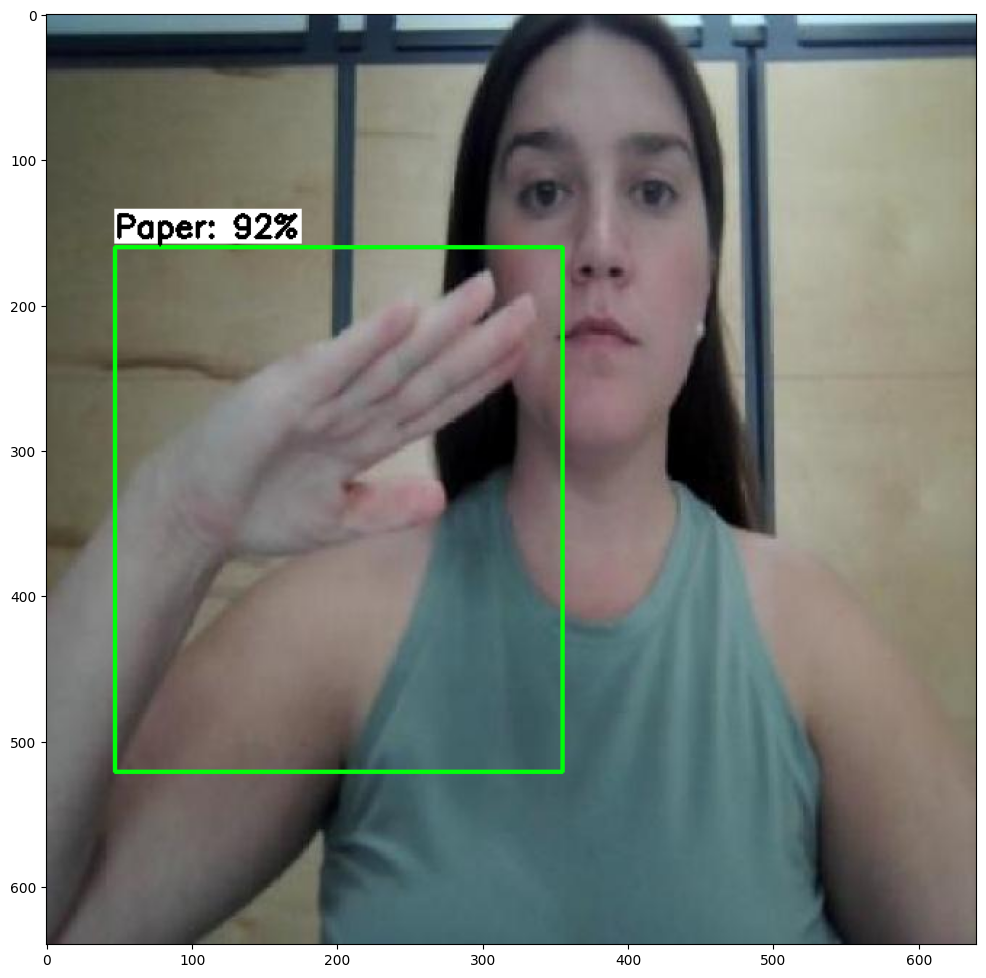

Inference time for Screen-Recording-2023-03-11-at-9_48_18-PM_mov-7_jpg.rf.2ff1d006866f54dc02e86037efd3e9ac.jpg: 0.0871 seconds


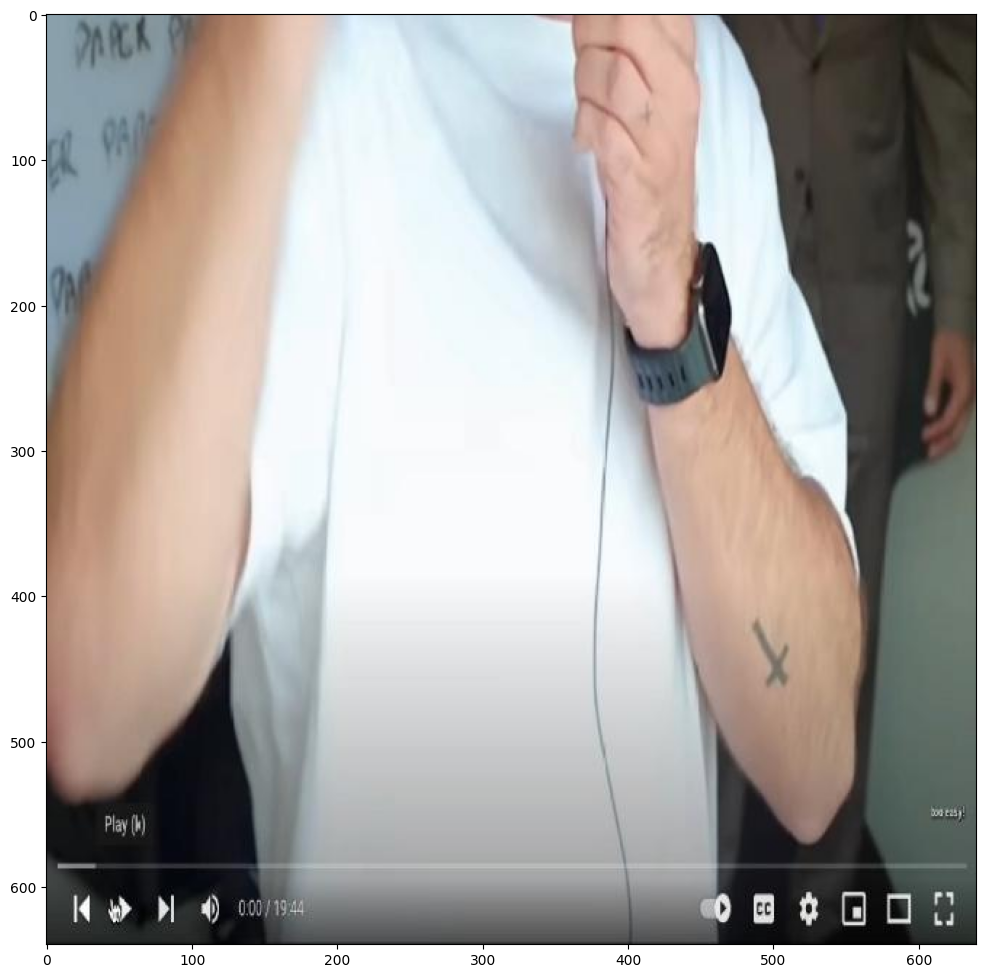

Inference time for Screen-Shot-2022-02-08-at-12-58-48-PM_png.rf.0f97b360502b3bc1b891663903b9f0a5.jpg: 0.0866 seconds


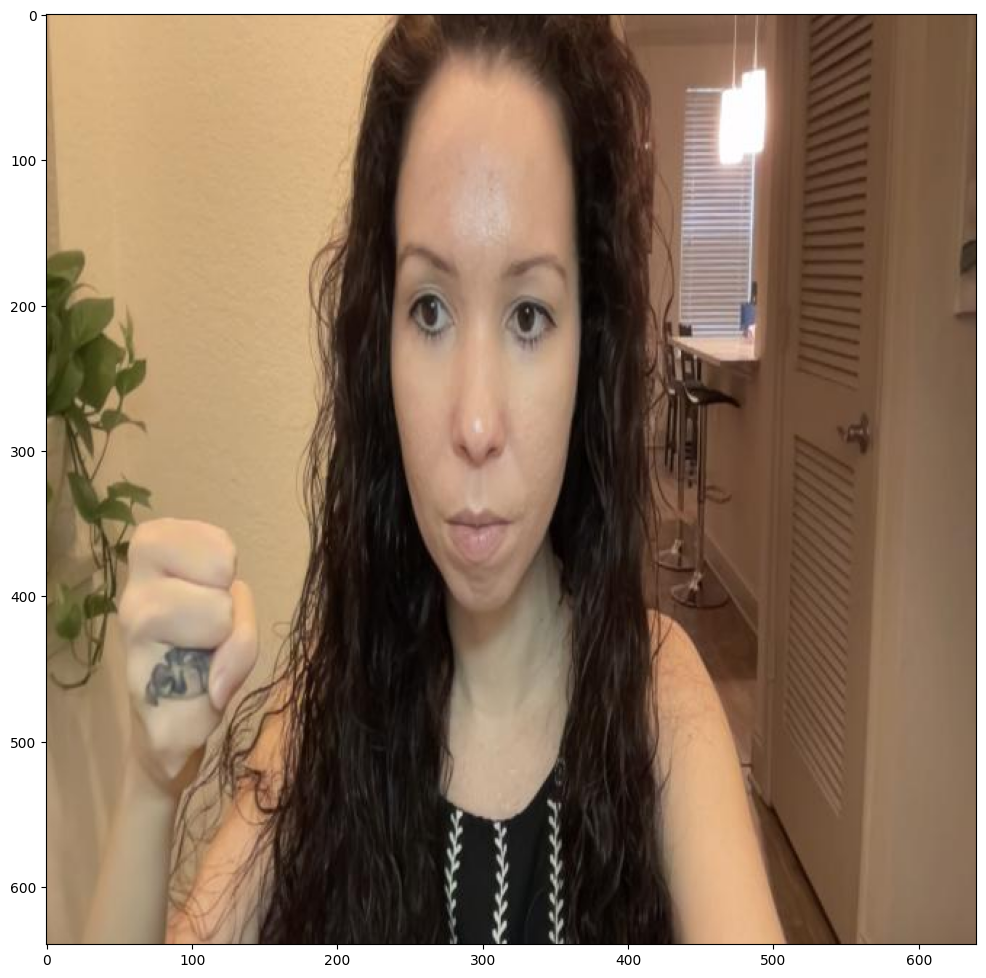

Inference time for zoom_tests_RockPaperScissors-mohamed_mp4-178_jpg.rf.ee8324347a3a0a594b255fd0a59fedcf.jpg: 0.0676 seconds


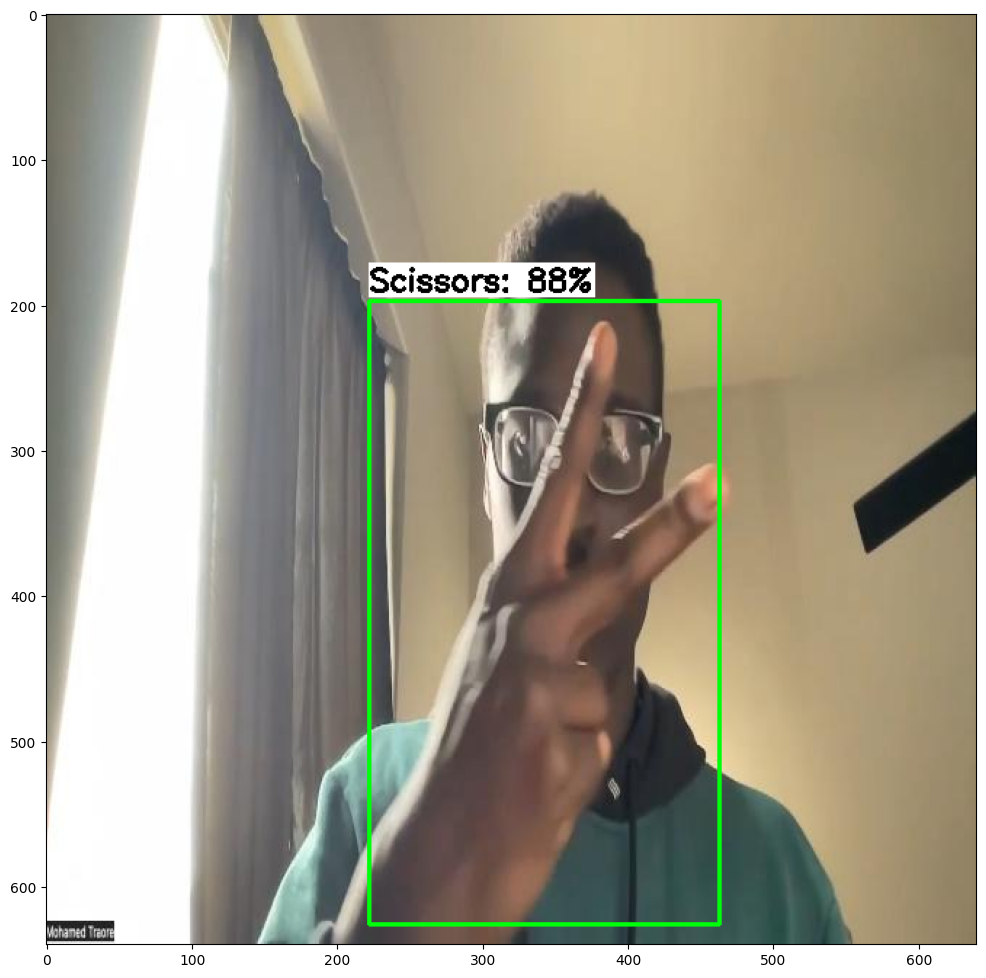

Inference time for egohands-public-1621363477842_png_jpg.rf.c4555a1ea52826e060ed06d311f8ab79.jpg: 0.0662 seconds


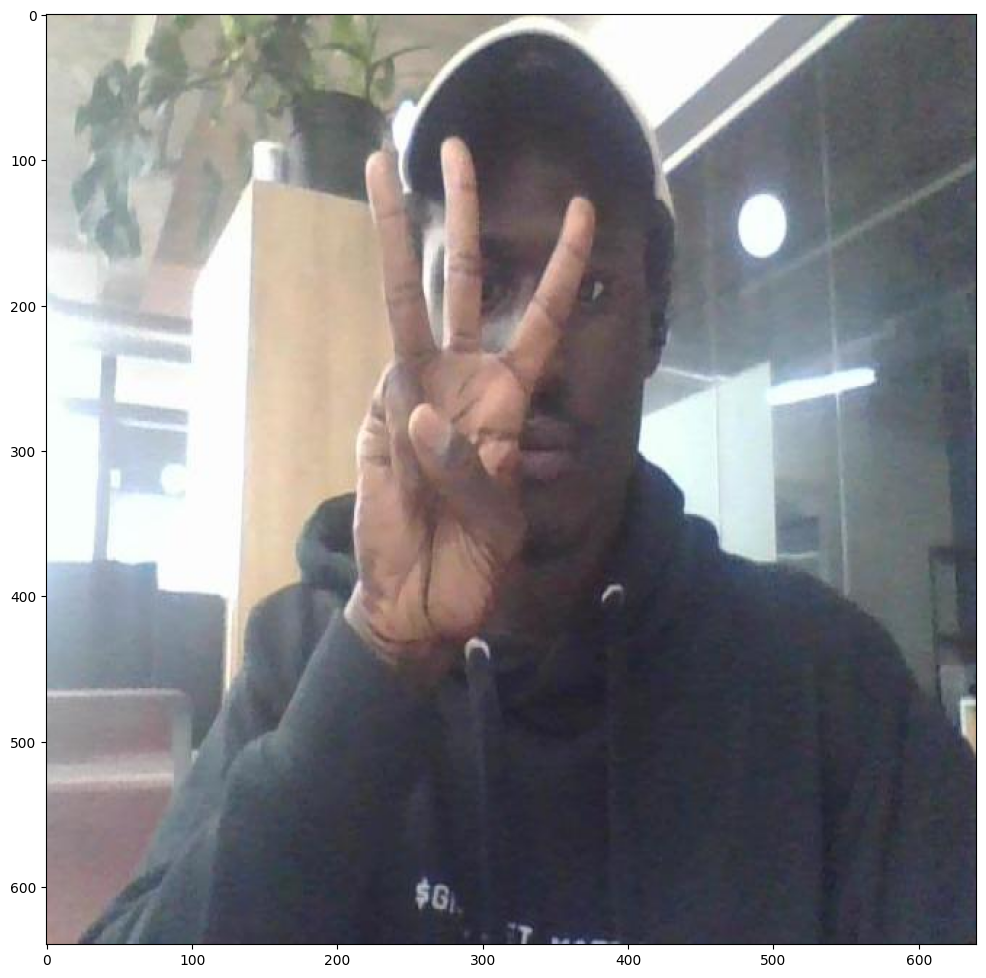

Inference time for chambre_resto_1_jpg.rf.22de5c723c4df940478c12c8f6e39093.jpg: 0.0750 seconds


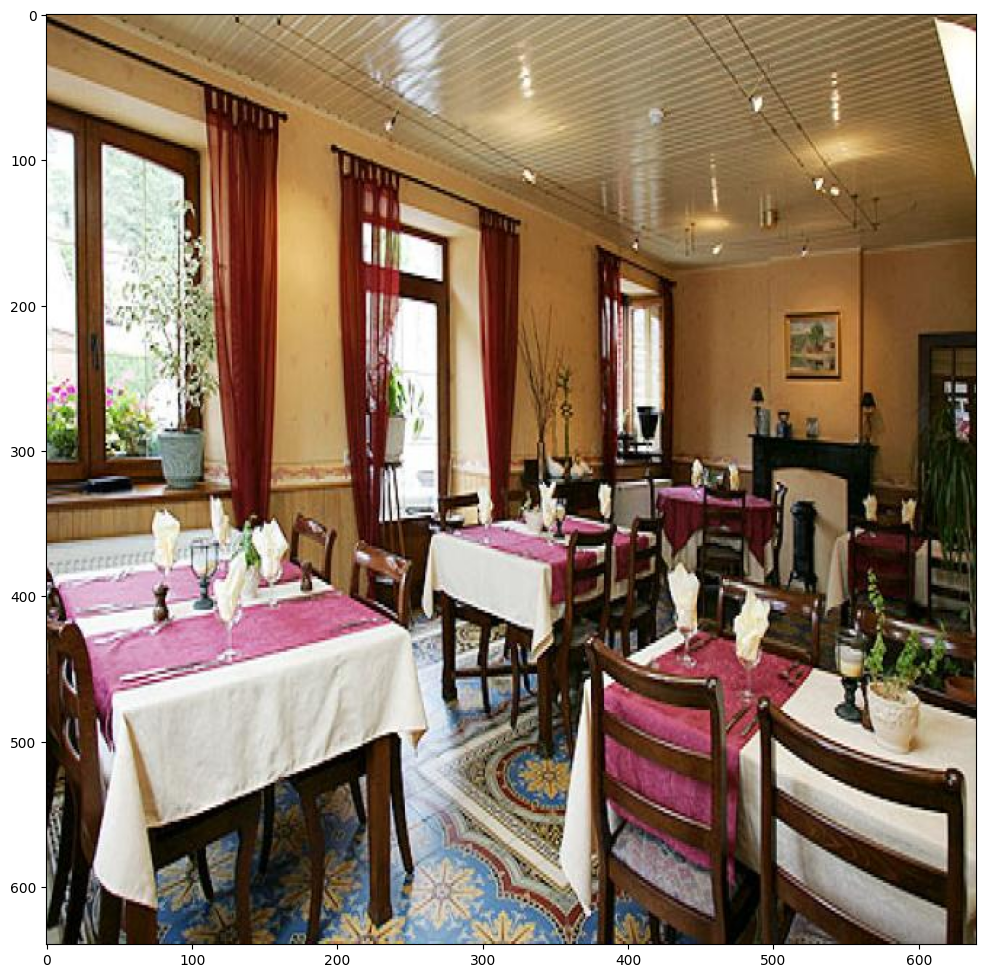

Inference time for zoom_tests_RockPaperScissors-mohamed_mp4-42_jpg.rf.67dfbb4133d5bd1c428aec6500bbc909.jpg: 0.0898 seconds


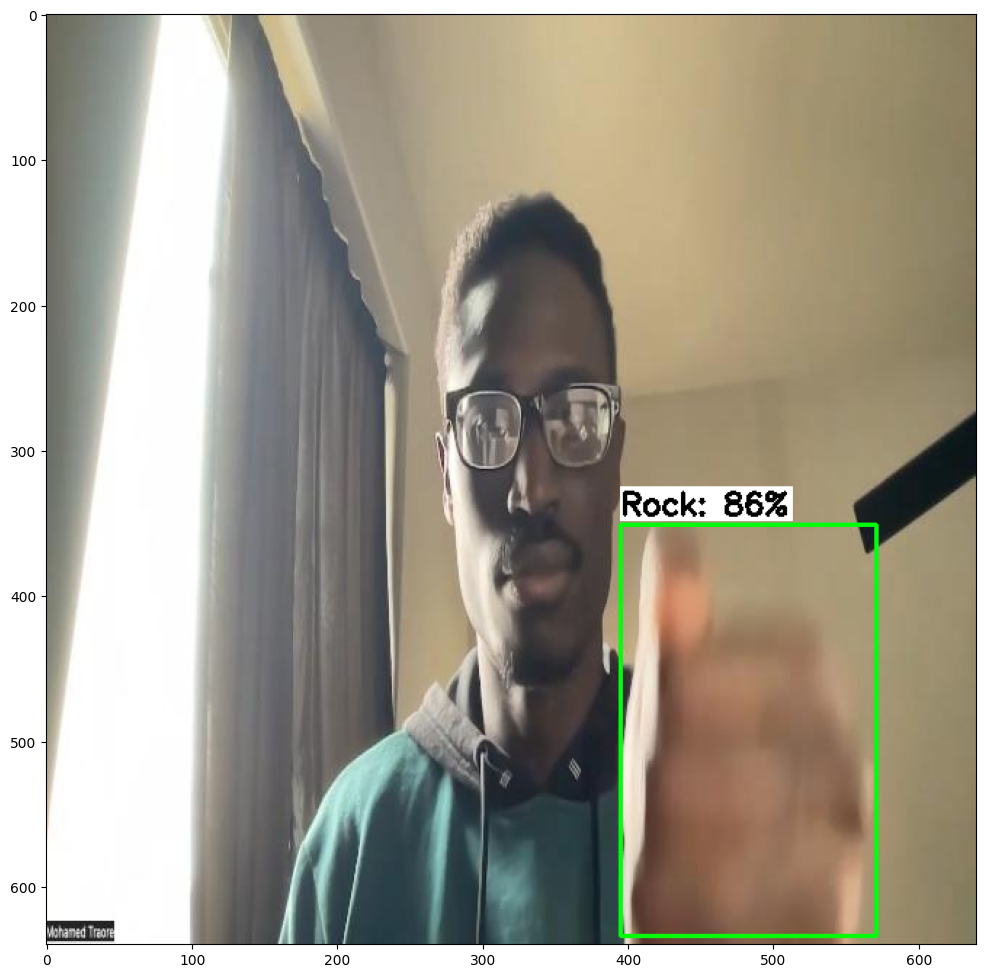

Inference time for youtube-139_jpg.rf.5d7aa1ef20cf3694a0bc6ded2049f31f.jpg: 0.0731 seconds


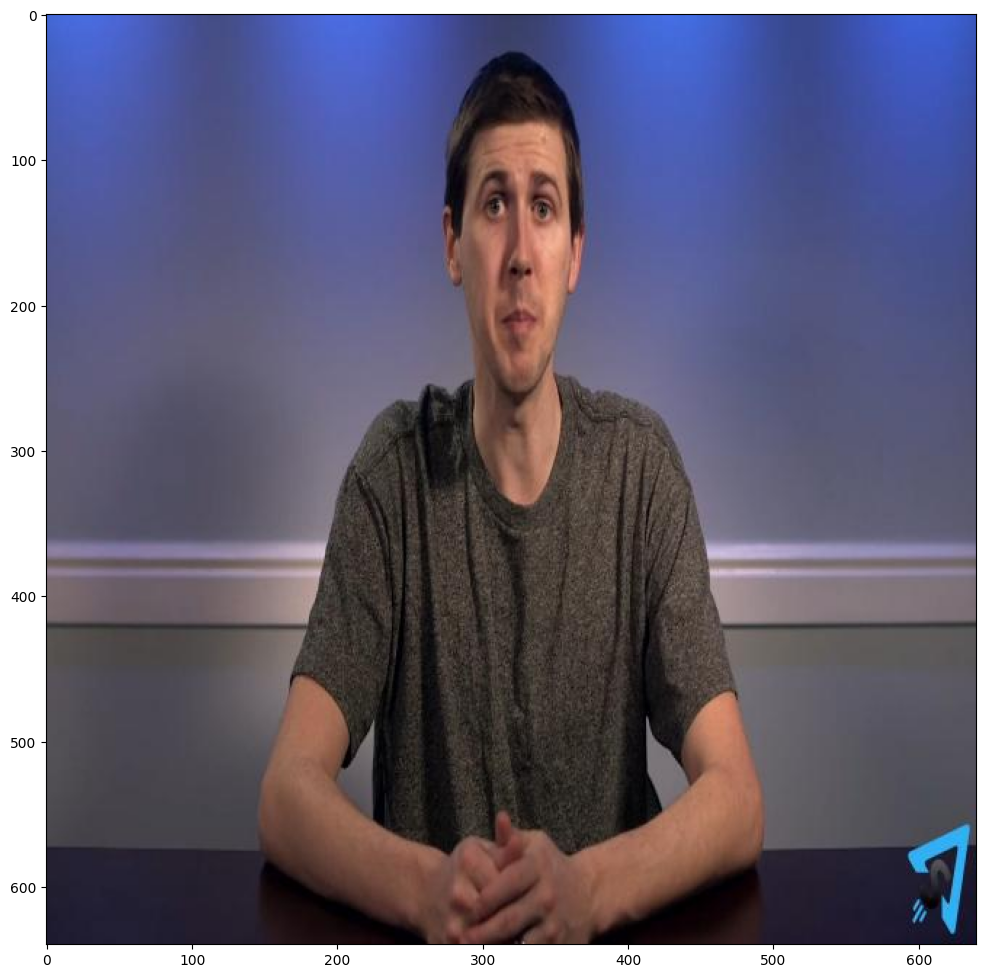

Inference time for carcel_139_19_flickr_jpg.rf.608ce249d6d4d2bd7de7001d3aad115d.jpg: 0.0687 seconds


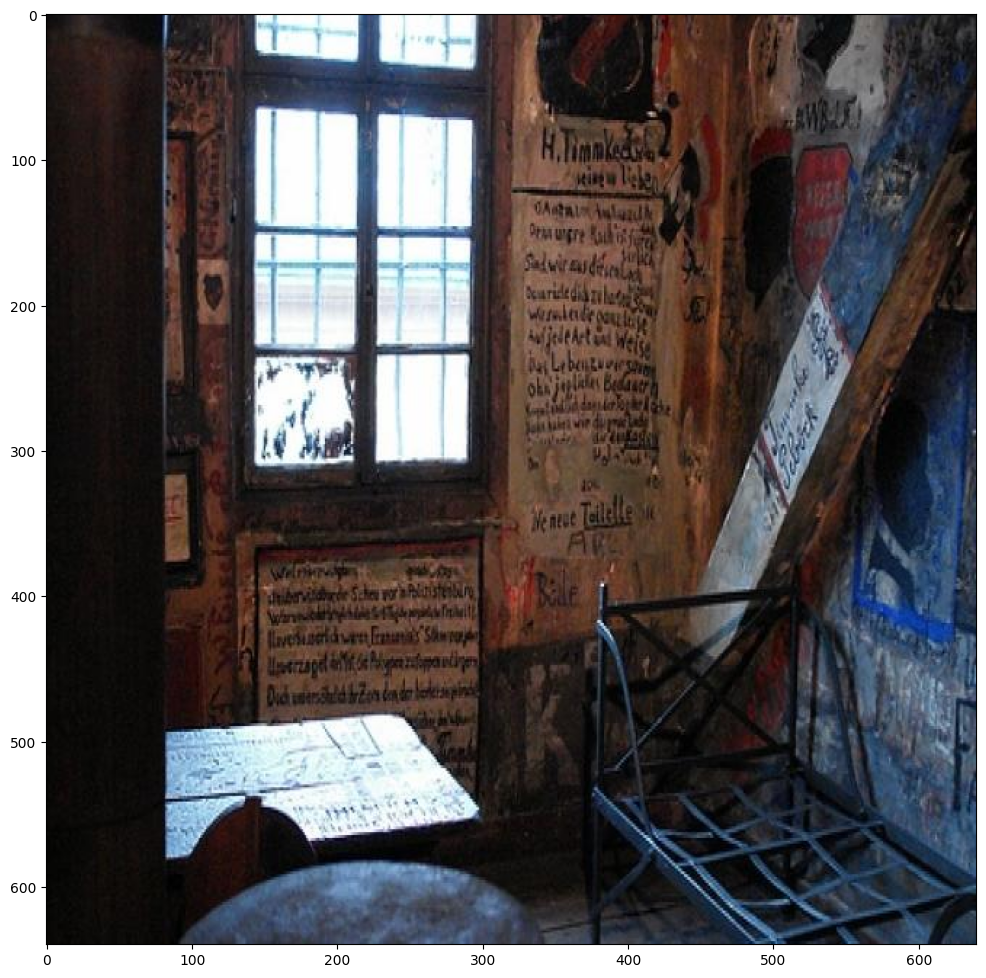

Inference time for zoom_tests_RockPaperScissors-mohamed_mp4-110_jpg.rf.e17cde25ba79b045f283a8fc44402bd3.jpg: 0.0758 seconds


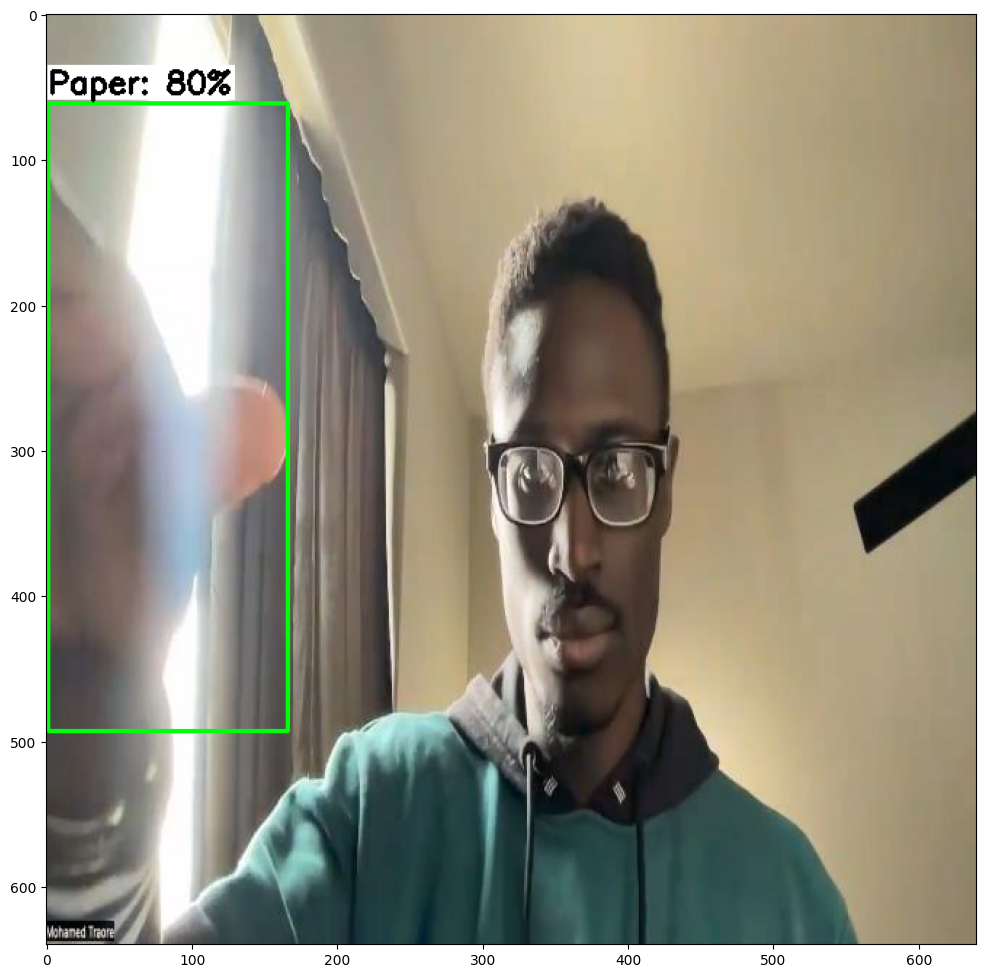

Inference time for Cool-Video-of-Ocean-Fish-Swimming_mp4-18_jpg.rf.1d10e523f1e57a1418ddb9b104a99c82.jpg: 0.0714 seconds


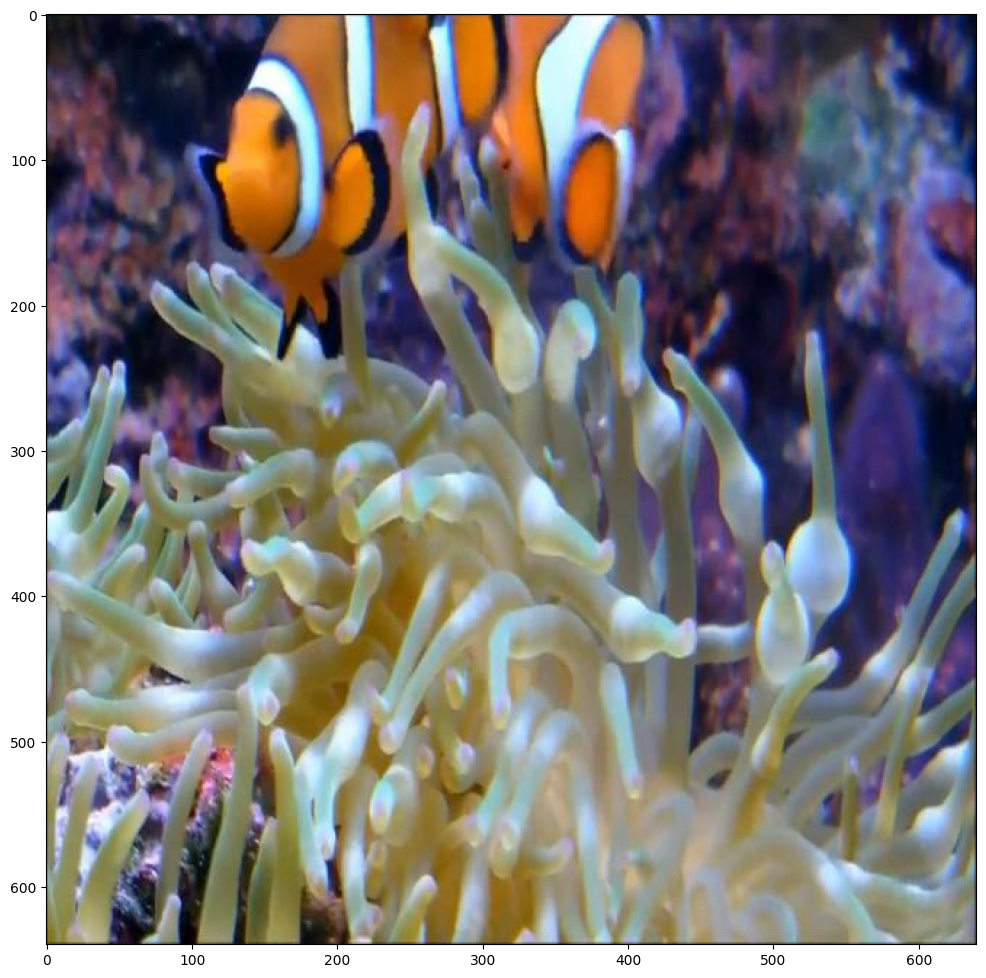

Inference time for Screen-Recording-2023-03-11-at-9_48_18-PM_mov-62_jpg.rf.d5a443ab6707f85b244d1cffedf5d410.jpg: 0.0718 seconds


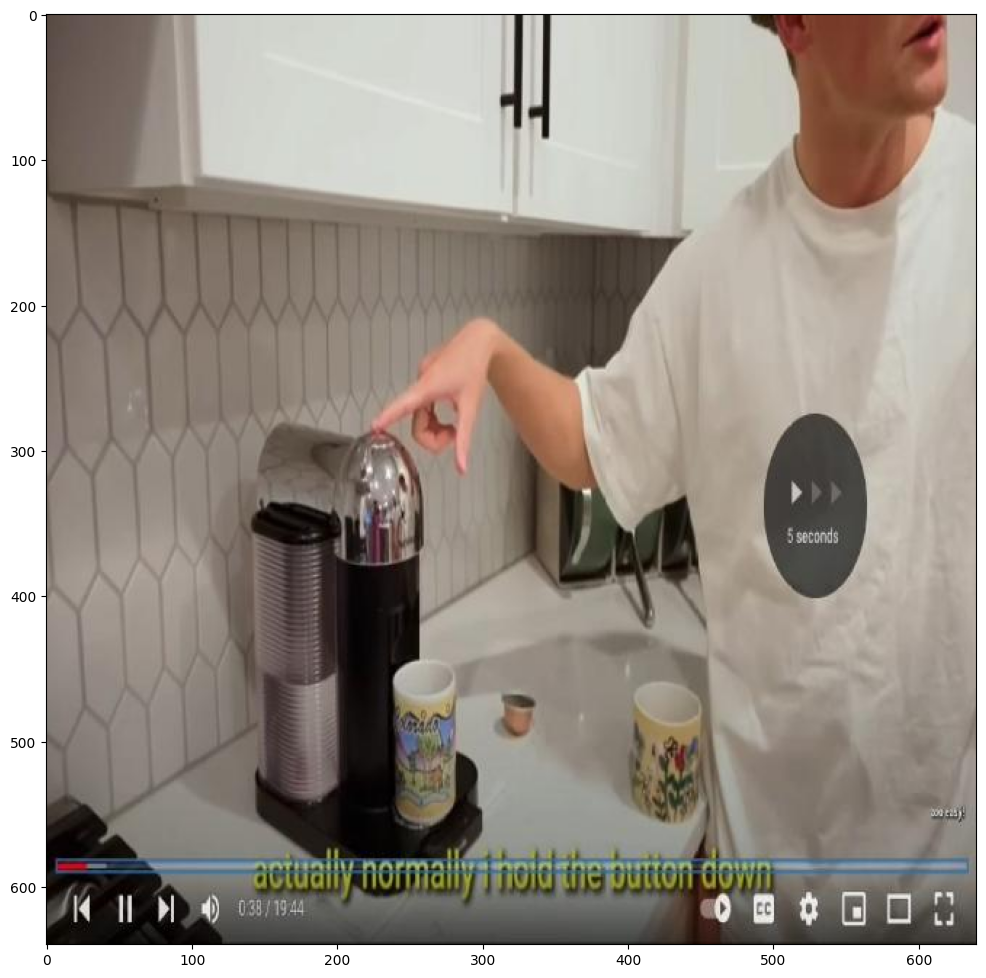

Inference time for Photo-on-2-16-22-at-10-20-AM-7_jpg.rf.04c02e8a8898821f6a8e1b3c12192c15.jpg: 0.0704 seconds


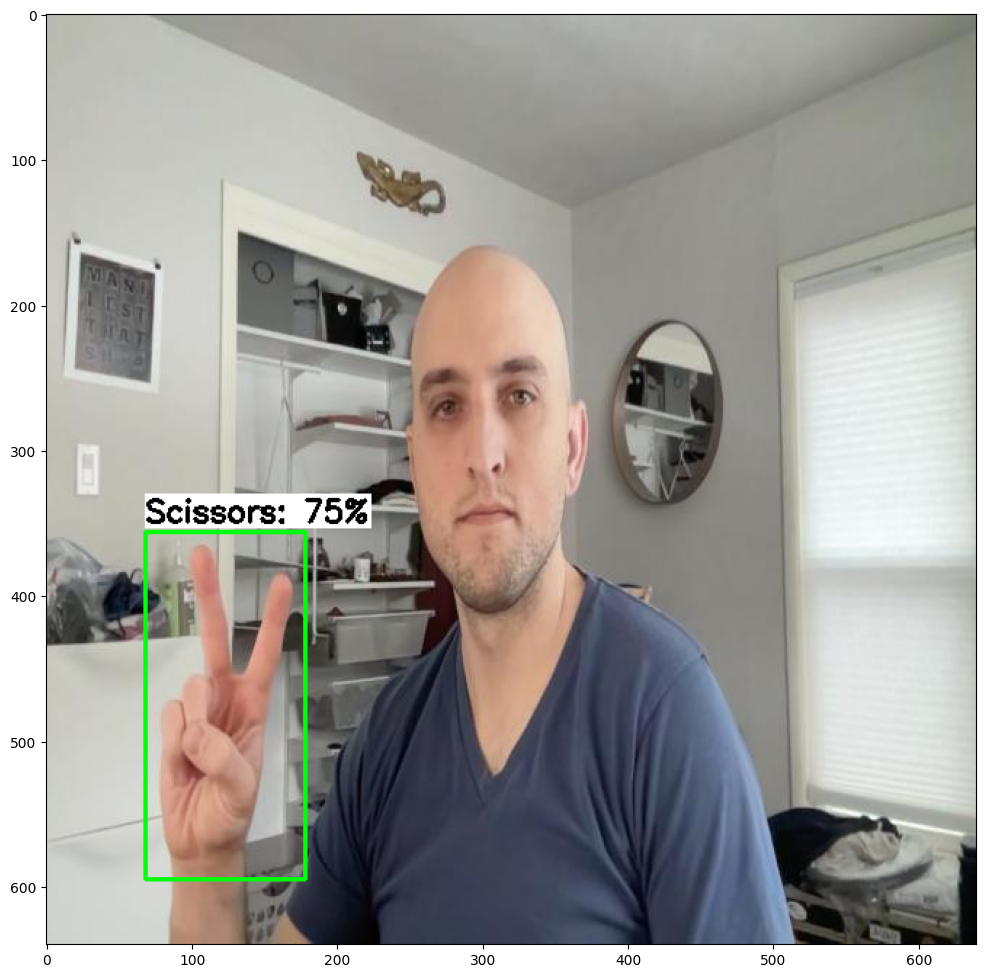

Inference time for youtube-50_jpg.rf.8feac9da5300444c7e16fa9ba30ce2f2.jpg: 0.0731 seconds


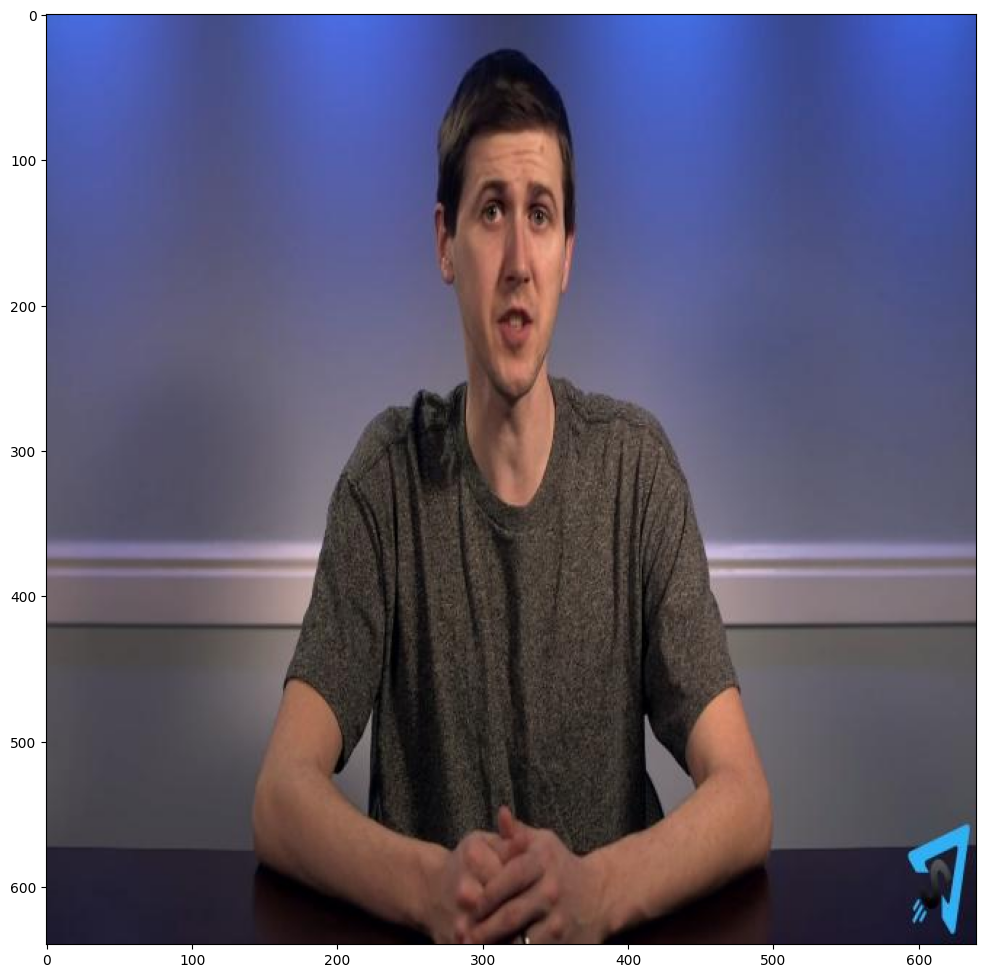

Inference time for IMG_7043_MOV-18_jpg.rf.a49776cf1eaf613d8f852b143e85caec.jpg: 0.0735 seconds


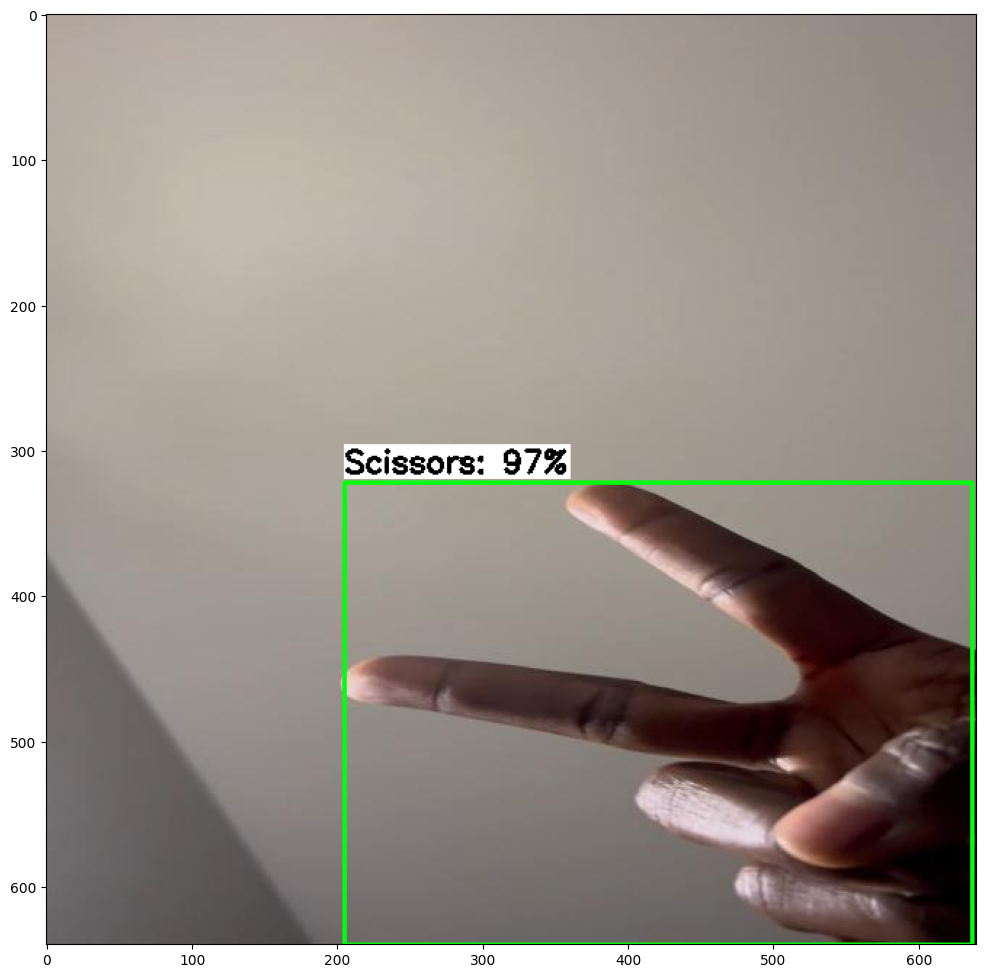

Inference time for IMG_7077_MOV-140_jpg.rf.ee1490b6ffd301843b9e0a8fe986e13a.jpg: 0.0694 seconds


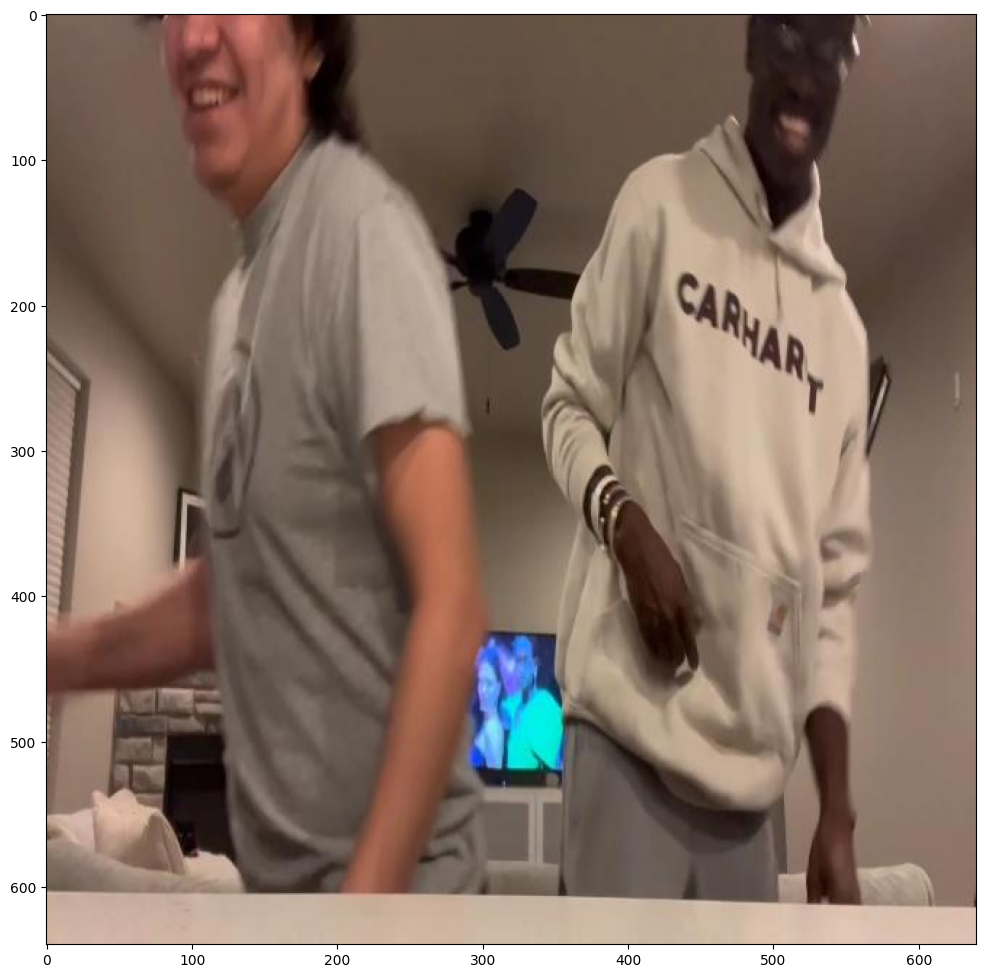

Inference time for Screen-Recording-2023-03-11-at-9_48_18-PM_mov-89_jpg.rf.7f2e37c792e26793cc71aaff4448613c.jpg: 0.0731 seconds


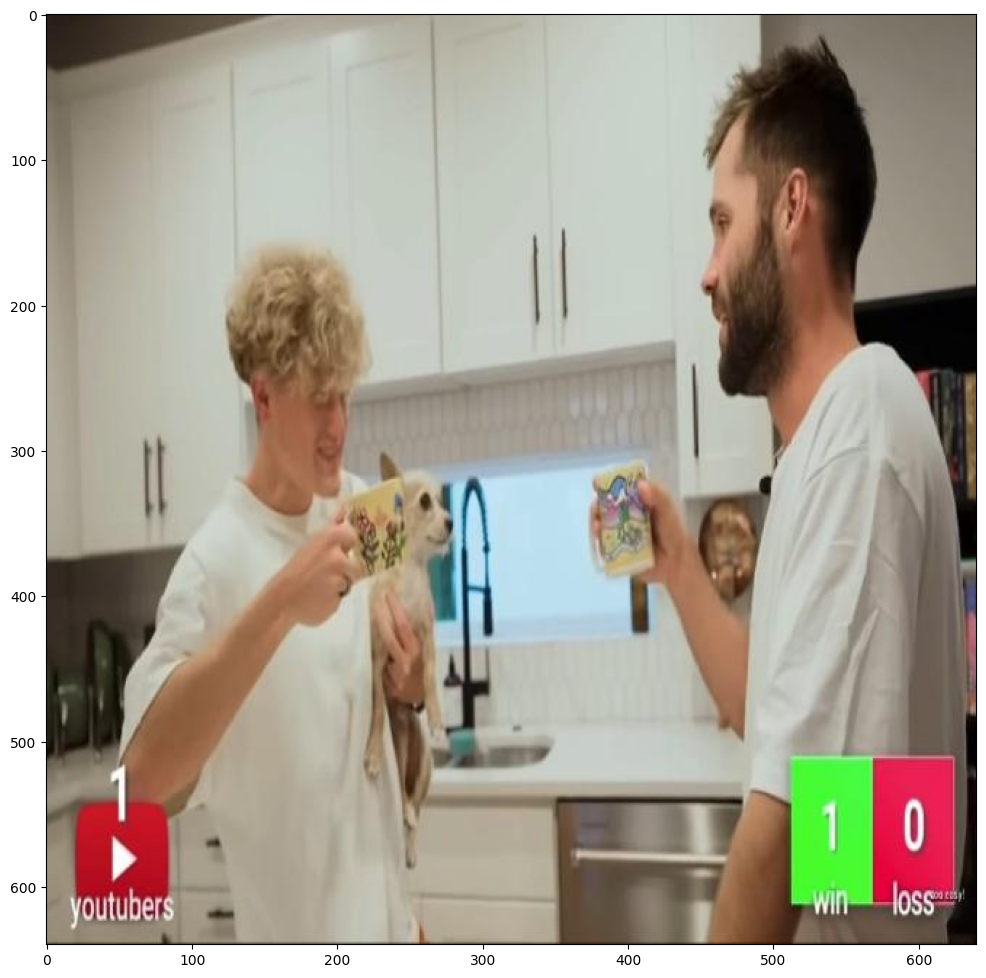

Inference time for egohands-public-1626201614270_png_jpg.rf.3d48501d9c5bb8ae3bafa6d5257e6db7.jpg: 0.0790 seconds


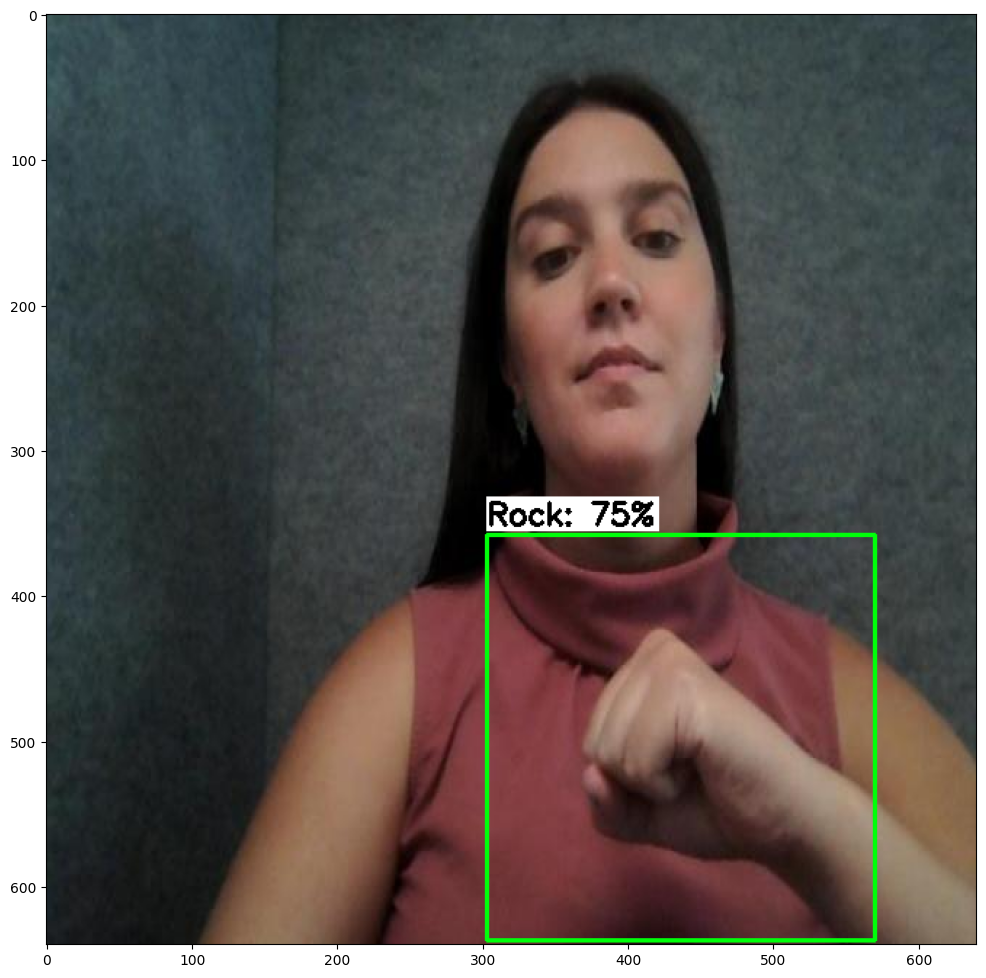

Inference time for youtube-137_jpg.rf.aa6adfefdcc6b129368507db98dee129.jpg: 0.0834 seconds


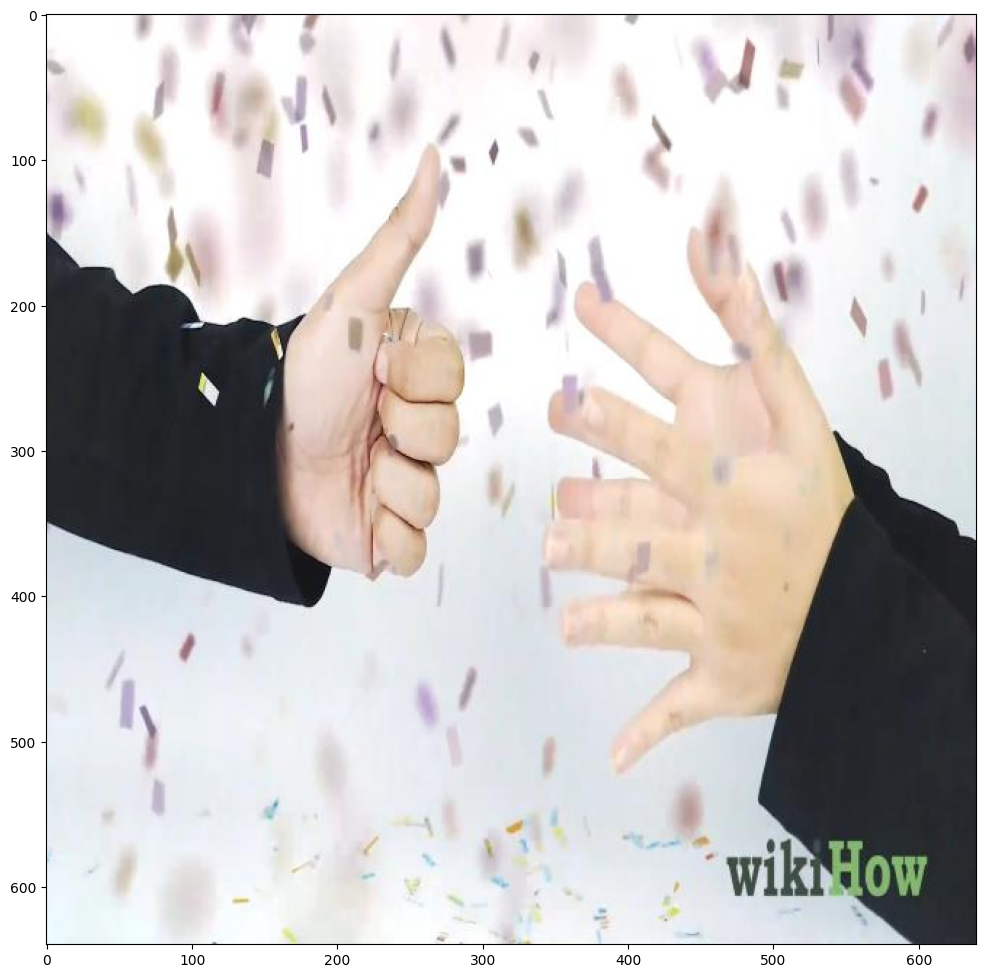

Inference time for zoom_tests_RockPaperScissors-mohamed_mp4-107_jpg.rf.056c26adf21336e65bd2ff9fcfe79df9.jpg: 0.0714 seconds


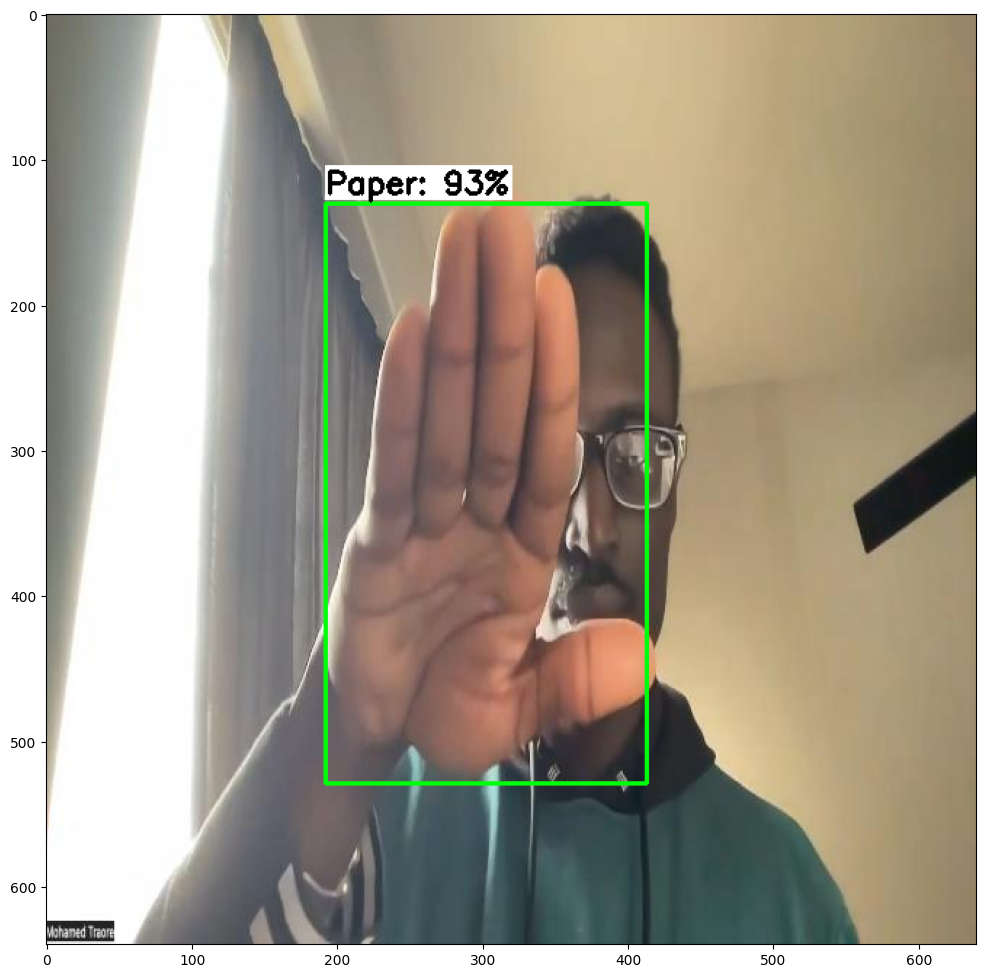

Inference time for Screen-Recording-2023-03-11-at-9_48_18-PM_mov-77_jpg.rf.1f20ac9d2c0e8e3926da5a83680839ce.jpg: 0.0849 seconds


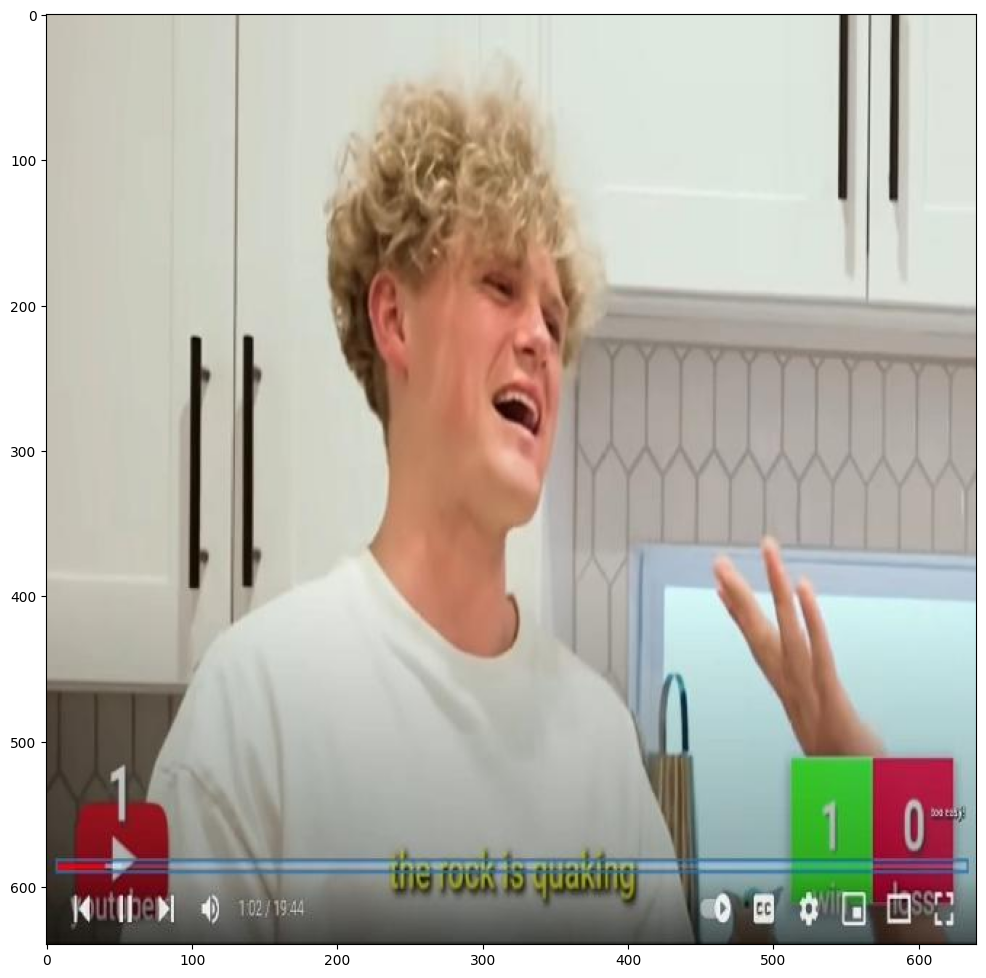

Inference time for egohands-public-1622730832103_png_jpg.rf.114588fe3eb0def9cc5eef067655fdd6.jpg: 0.0856 seconds


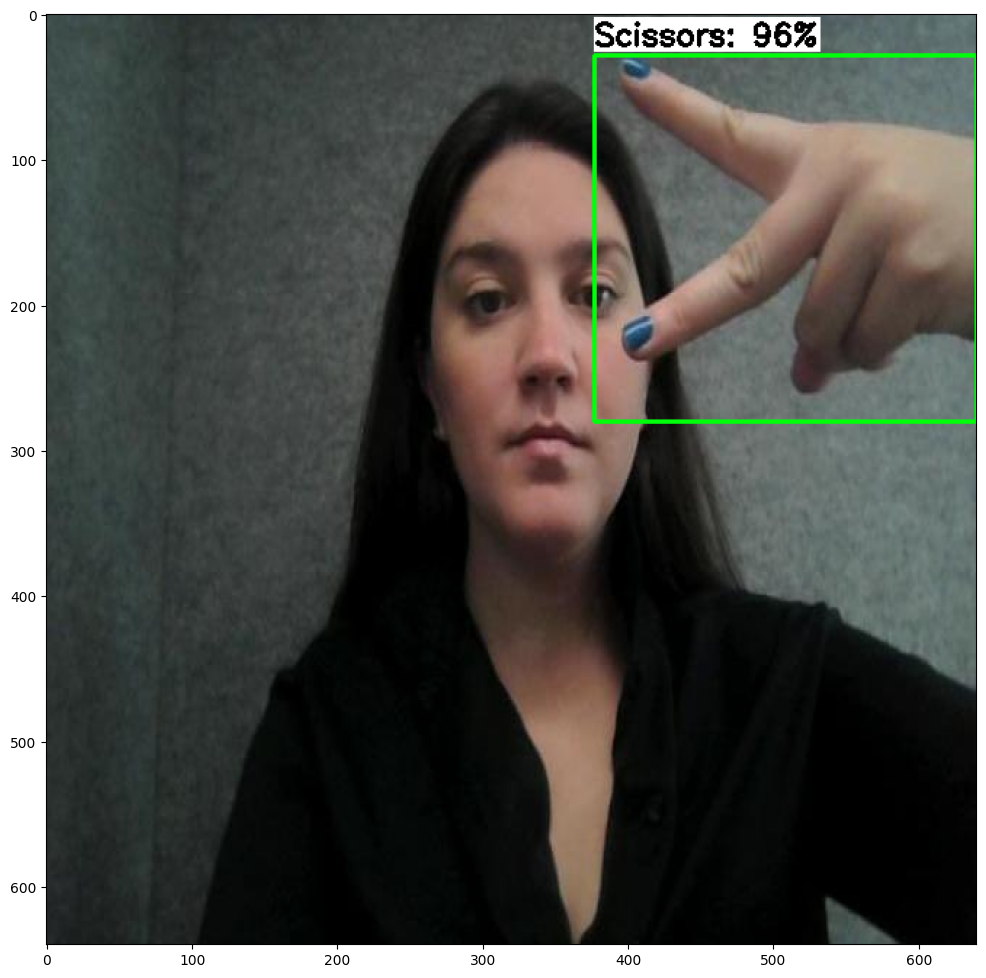

Inference time for youtube-40_jpg.rf.a39bd6b610c103709408b34c32d3b97f.jpg: 0.0691 seconds


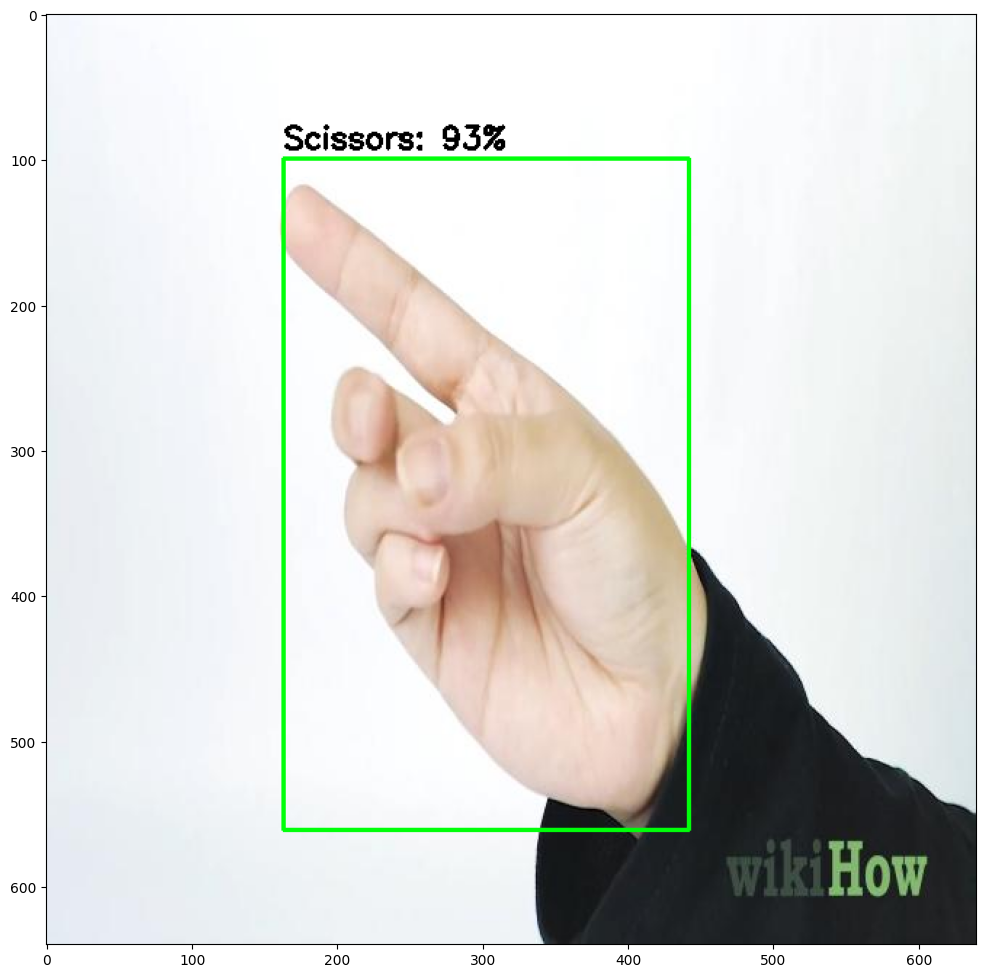

Inference time for youtube-37_jpg.rf.c37e20e61025e5b29cf34add1e2ee3bc.jpg: 0.0796 seconds


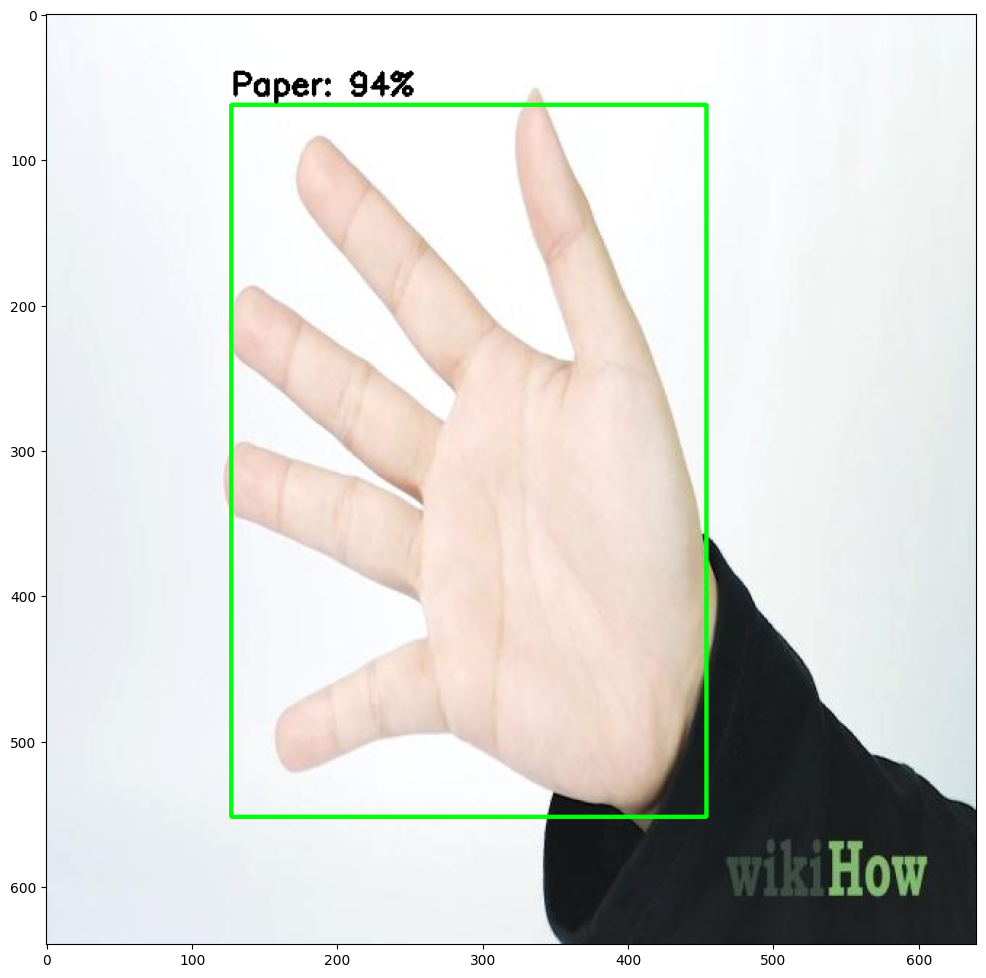

Inference time for Screen-Recording-2023-03-11-at-9_48_18-PM_mov-289_jpg.rf.955e6ecd36bb97279951f81b4dd8e373.jpg: 0.0871 seconds


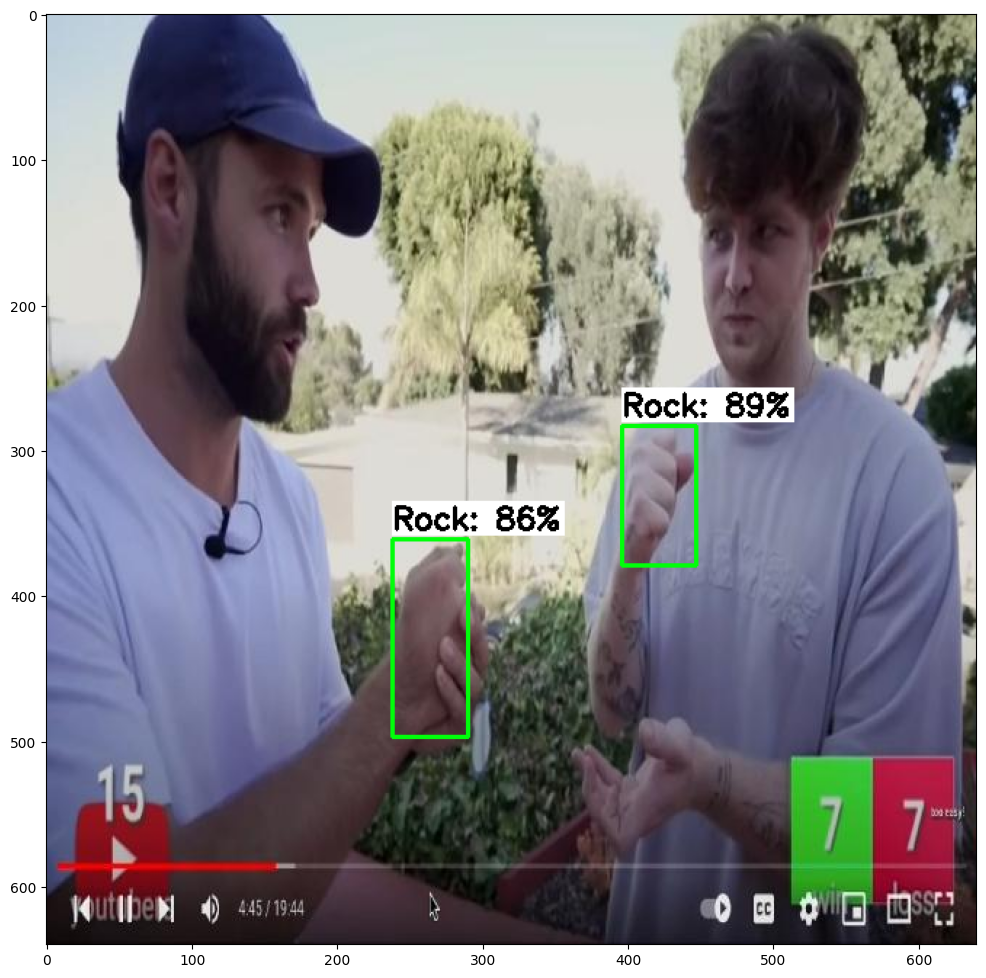

Inference time for egohands-public-1624563408999_png_jpg.rf.91ce76eb19209917f78da8ae04f7866c.jpg: 0.0934 seconds


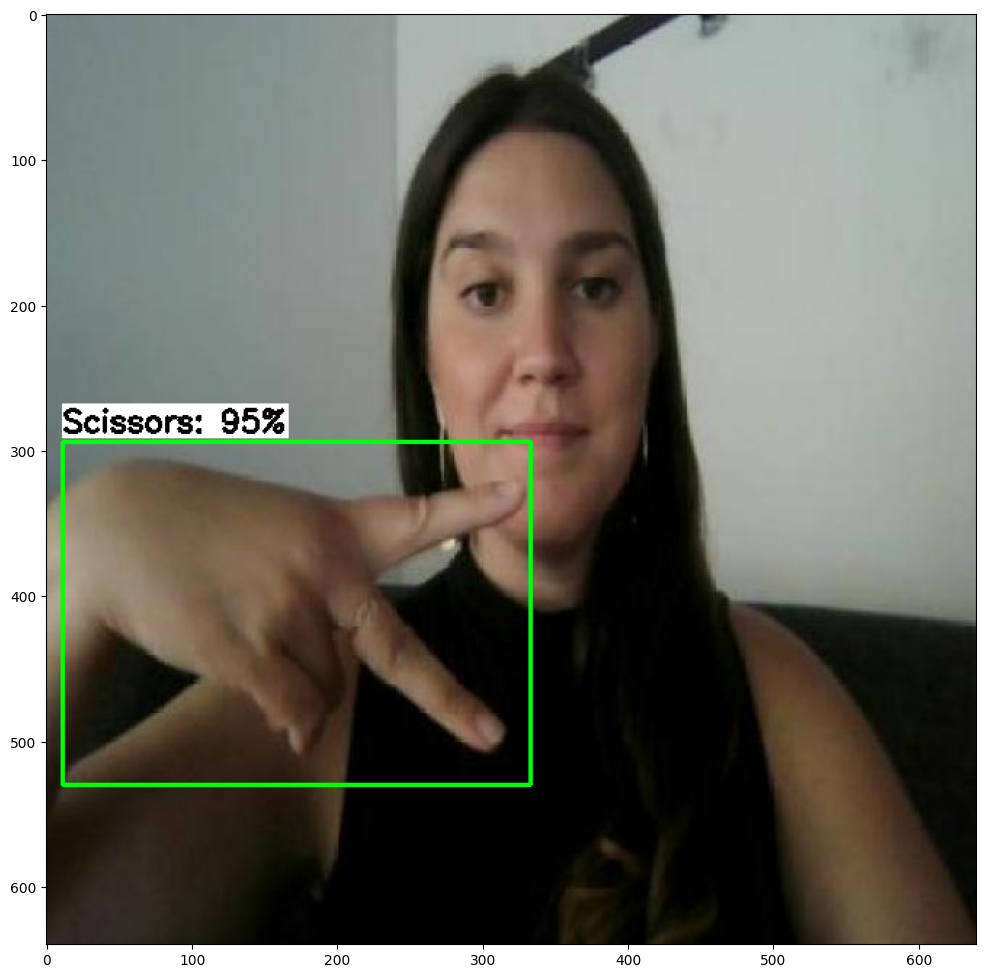

Inference time for youtube-59_jpg.rf.60f4826abbf282fb647605441bfb1024.jpg: 0.0765 seconds


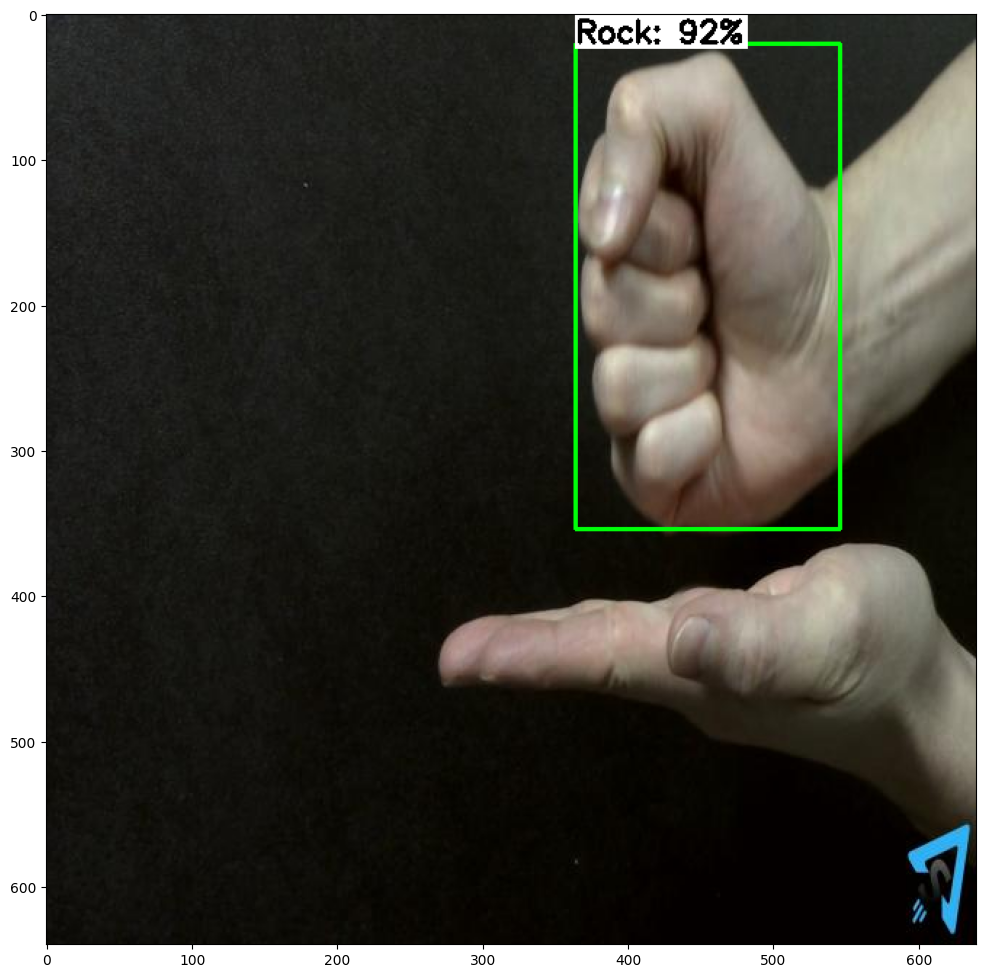

In [ ]:
# Set up variables for running user's model
PATH_TO_IMAGES='/content/test/'   # Path to test images folder
PATH_TO_MODEL='/content/content/custom_model_lite/detect.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/labelmap.txt'   # Path to labelmap.txt file
min_conf_threshold=0.5   # Confidence threshold (try changing this to 0.01 if you don't see any detection results)
images_to_test = 30   # Number of images to run detection on

# Run inferencing function!
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test)

# Evaluate Model

In [ ]:
%%bash
git clone https://github.com/Cartucho/mAP /content/mAP
cd /content/mAP
rm input/detection-results/*
rm input/ground-truth/*
rm input/images-optional/*
wget https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py

Cloning into '/content/mAP'...
--2024-10-26 07:34:17--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5397 (5.3K) [text/plain]
Saving to: ‘calculate_map_cartucho.py’

     0K .....                                                 100% 40.8M=0s

2024-10-26 07:34:17 (40.8 MB/s) - ‘calculate_map_cartucho.py’ saved [5397/5397]



In [ ]:
!cp /content/test/* /content/mAP/input/images-optional # Copy images and xml files
!mv /content/mAP/input/images-optional/*.xml /content/mAP/input/ground-truth/  # Move xml files to the appropriate folder

In [ ]:
# Set up variables for running inference, this time to get detection results saved as .txt files
PATH_TO_IMAGES='/content/test'   # Path to test images folder
PATH_TO_MODEL='/content/content/custom_model_lite/detect.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/labelmap.txt'   # Path to labelmap.txt file
PATH_TO_RESULTS='/content/mAP/input/detection-results' # Folder to save detection results in
min_conf_threshold=0.1   # Confidence threshold

# Use all the images in the test folder
image_list = glob.glob(PATH_TO_IMAGES + '/*.jpg') + glob.glob(PATH_TO_IMAGES + '/*.JPG') + glob.glob(PATH_TO_IMAGES + '/*.png') + glob.glob(PATH_TO_IMAGES + '/*.bmp')
images_to_test = min(500, len(image_list)) # If there are more than 500 images in the folder, just use 500

# Tell function to just save results and not display images
txt_only = True

# Run inferencing function!
print('Starting inference on %d images...' % images_to_test)
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test, PATH_TO_RESULTS, txt_only)
print('Finished inferencing!')

Starting inference on 304 images...
Finished inferencing!


In [ ]:
!python /content/mAP/scripts/extra/convert_gt_xml.py

Conversion completed!


In [ ]:
%cd /content/mAP
!python calculate_map_cartucho.py --labels=/content/labelmap.txt

/content/mAP
Calculating mAP at 0.50 IoU threshold...
84.98% = Paper AP 
89.89% = Rock AP 
92.08% = Scissors AP 
mAP = 88.98%
Calculating mAP at 0.55 IoU threshold...
83.40% = Paper AP 
89.89% = Rock AP 
92.08% = Scissors AP 
mAP = 88.46%
Calculating mAP at 0.60 IoU threshold...
80.16% = Paper AP 
89.89% = Rock AP 
90.44% = Scissors AP 
mAP = 86.83%
Calculating mAP at 0.65 IoU threshold...
73.71% = Paper AP 
85.74% = Rock AP 
89.27% = Scissors AP 
mAP = 82.91%
Calculating mAP at 0.70 IoU threshold...
69.24% = Paper AP 
85.74% = Rock AP 
89.27% = Scissors AP 
mAP = 81.42%
Calculating mAP at 0.75 IoU threshold...
56.82% = Paper AP 
75.17% = Rock AP 
87.36% = Scissors AP 
mAP = 73.12%
Calculating mAP at 0.80 IoU threshold...
42.48% = Paper AP 
69.13% = Rock AP 
78.80% = Scissors AP 
mAP = 63.47%
Calculating mAP at 0.85 IoU threshold...
31.21% = Paper AP 
46.86% = Rock AP 
59.22% = Scissors AP 
mAP = 45.76%
Calculating mAP at 0.90 IoU threshold...
12.67% = Paper AP 
24.83% = Rock AP 
34.70

In [ ]:
from google.colab import files
import os

dir_to_zip = '/content/mAP' #@param {type: "string"}
output_filename = 'midtermsSSD_Evaluation.zip' #@param {type: "string"}
delete_dir_after_download = "No"  #@param ['Yefcs', 'No']

os.system( "zip -r {} {}".format( output_filename , dir_to_zip ) )

if delete_dir_after_download == "Yes":
    os.system( "rm -r {}".format( dir_to_zip ) )

files.download( output_filename )

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>